# Entrenamiento de la red

## Instalando los requerimientos para la red



In [ ]:
#clone YOLOv5 and 
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
%pip install -qr requirements.txt # install dependencies
%pip install -q roboflow

import torch
import os
from IPython.display import Image, clear_output  # to display images

print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

Cloning into 'yolov5'...
remote: Enumerating objects: 14378, done.
remote: Counting objects: 100% (7/7), done.
remote: Compressing objects: 100% (6/6), done.
remote: Total 14378 (delta 1), reused 2 (delta 0), pack-reused 14371
Receiving objects: 100% (14378/14378), 13.60 MiB | 34.21 MiB/s, done.
Resolving deltas: 100% (9902/9902), done.
/content/yolov5
     |████████████████████████████████| 182 kB 13.9 MB/s 
     |████████████████████████████████| 62 kB 1.5 MB/s 
     |████████████████████████████████| 1.6 MB 72.1 MB/s 
     |████████████████████████████████| 42 kB 937 kB/s 
     |████████████████████████████████| 145 kB 25.6 MB/s 
     |████████████████████████████████| 178 kB 31.8 MB/s 
     |████████████████████████████████| 138 kB 66.9 MB/s 
     |████████████████████████████████| 67 kB 6.9 MB/s 
     |████████████████████████████████| 54 kB 3.5 MB/s 
     |████████████████████████████████| 62 kB 1.7 MB/s 
Setup complete. Using torch 1.12.1+cu113 (Tesla T4)


# Importar base de datos desde Roboflow

In [ ]:
from roboflow import Roboflow
rf = Roboflow(model_format="yolov5", notebook="examen-dl")

upload and label your dataset, and get an API KEY here: https://app.roboflow.com/?model=yolov5&ref=examen-dl


In [ ]:
from roboflow import Roboflow
rf = Roboflow(api_key="PYyFWu0FPjlMYMmlUIkG")
project = rf.workspace().project("examen-dl")
dataset = project.version(2).download("yolov5")

loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to examen-DL--2 in yolov5pytorch:: 100%|██████████| 3062/3062 [00:01<00:00, 2014.16it/s]


In [ ]:
os.environ["DATASET_DIRECTORY"] = "/content/datasets"

In [ ]:
!python train.py --img 640 --batch 16 --epochs 200 --data {dataset.location}/data.yaml --weights yolov5s.pt --cache #1:50

train: weights=yolov5s.pt, cfg=, data=/content/yolov5/examen-DL--2/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=200, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-27-g454dae1 Python-3.8.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.0

In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs


The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 273), started 1:24:20 ago. (Use '!kill 273' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
!python detect.py --weights runs/train/exp3/weights/best.pt --img 640 --conf 0.1 --source {dataset.location}/test/images

detect: weights=['runs/train/exp3/weights/best.pt'], source=/content/yolov5/examen-DL--2/test/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-27-g454dae1 Python-3.8.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 157 layers, 7026307 parameters, 0 gradients, 15.8 GFLOPs
image 1/139 /content/yolov5/examen-DL--2/test/images/01_missing_hole_07_jpg.rf.806f8118cdeba3e2b32435ebd8c7cce1.jpg: 640x640 3 missing_holes, 12.7ms
image 2/139 /content/yolov5/examen-DL--2/test/images/01_missing_hole_09_jpg.rf.dba80aa731be3fd1e02982eda94f91e1.jpg: 640x640 3 missing_holes, 12.8ms
image 3/139 /content/yolov5/

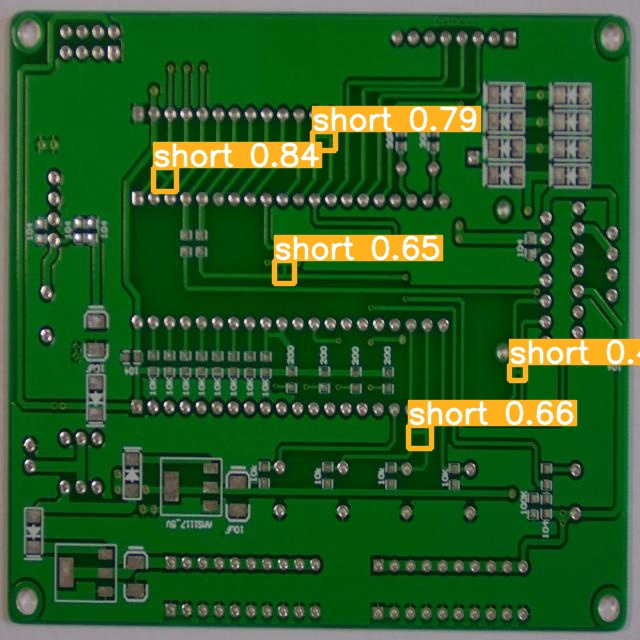

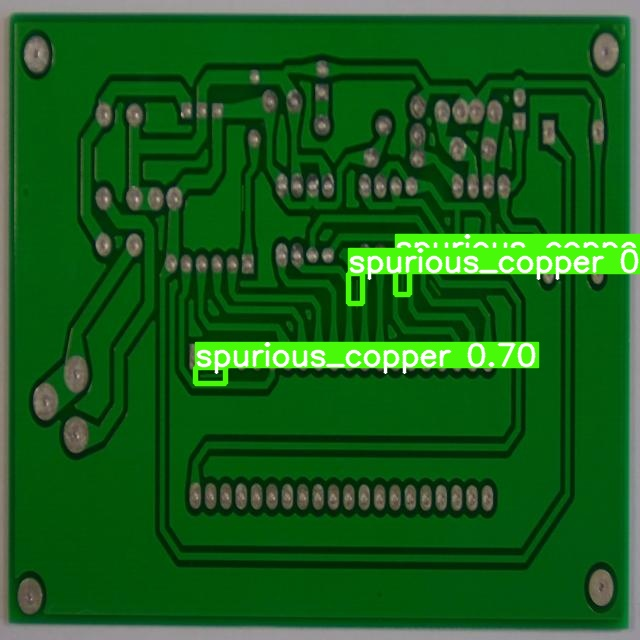

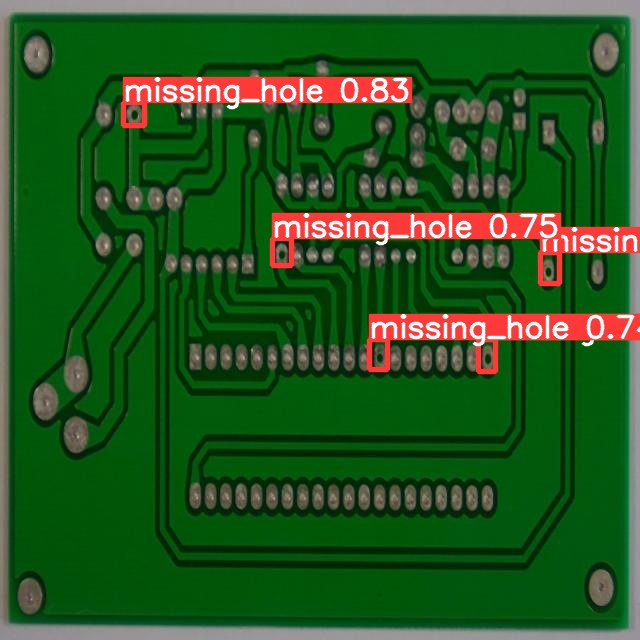

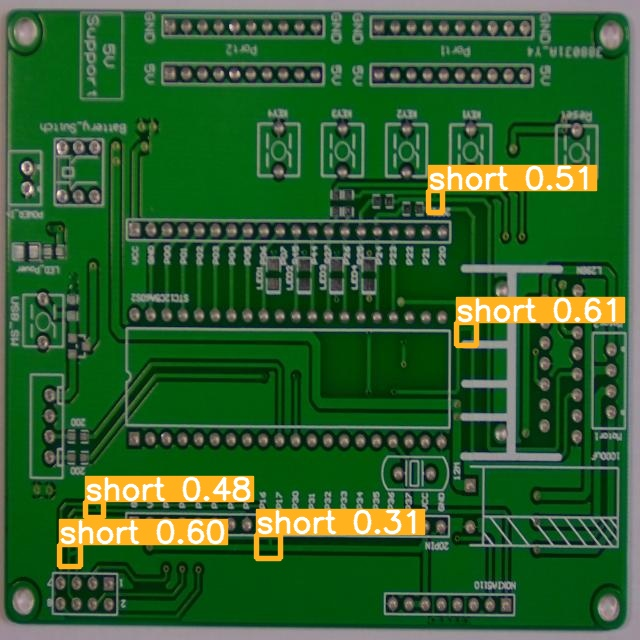

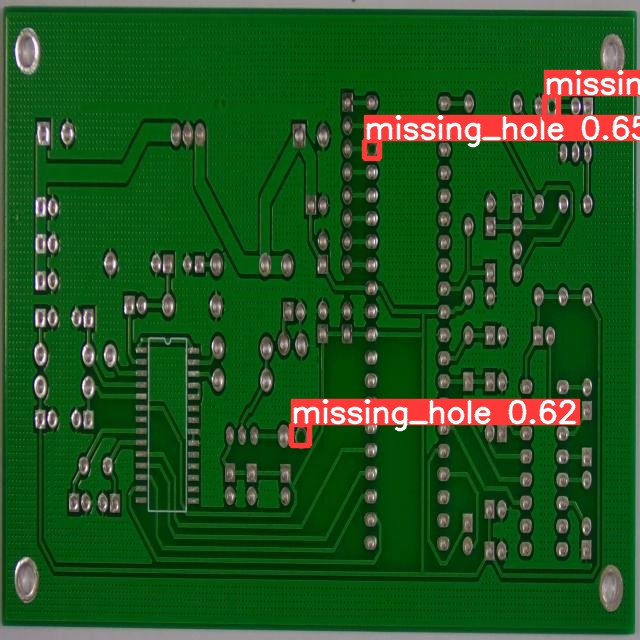

...

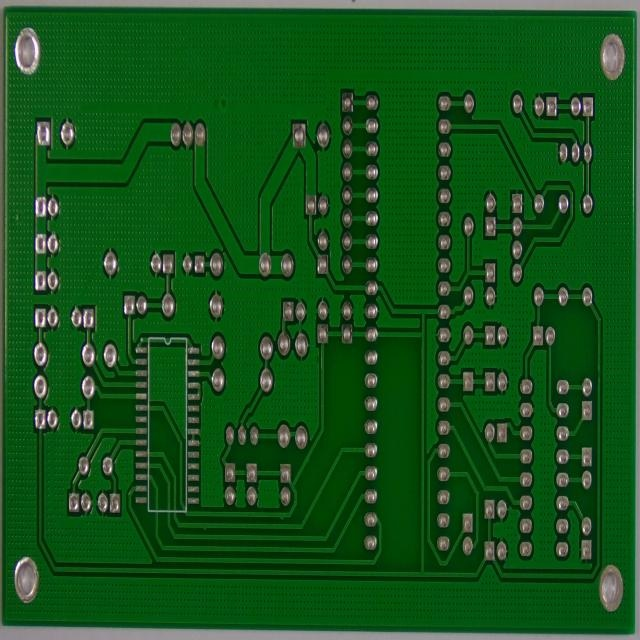

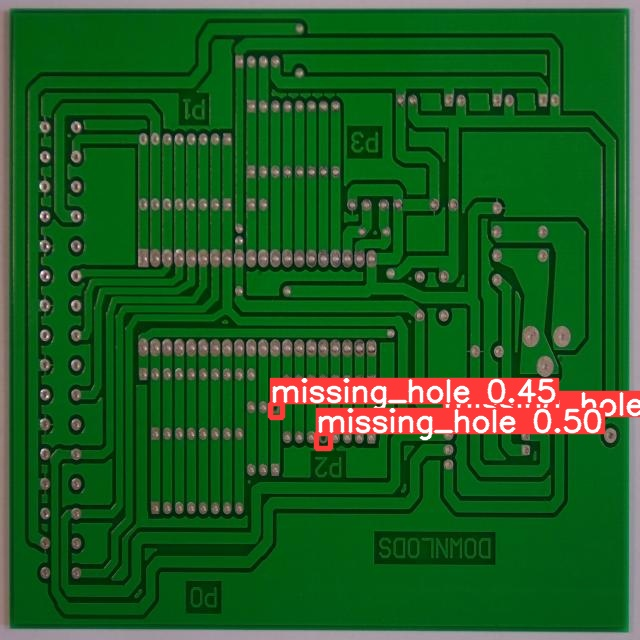

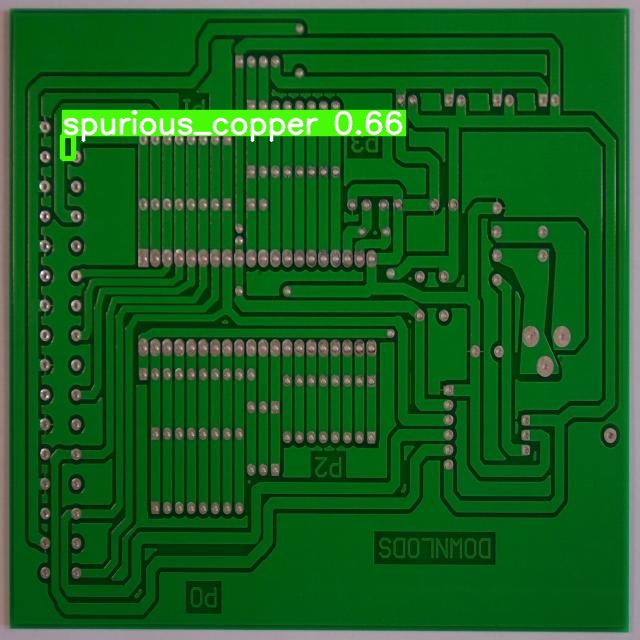

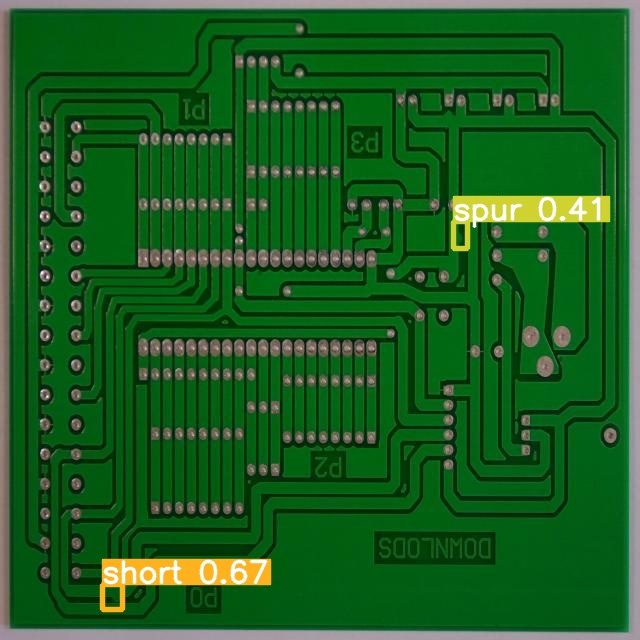

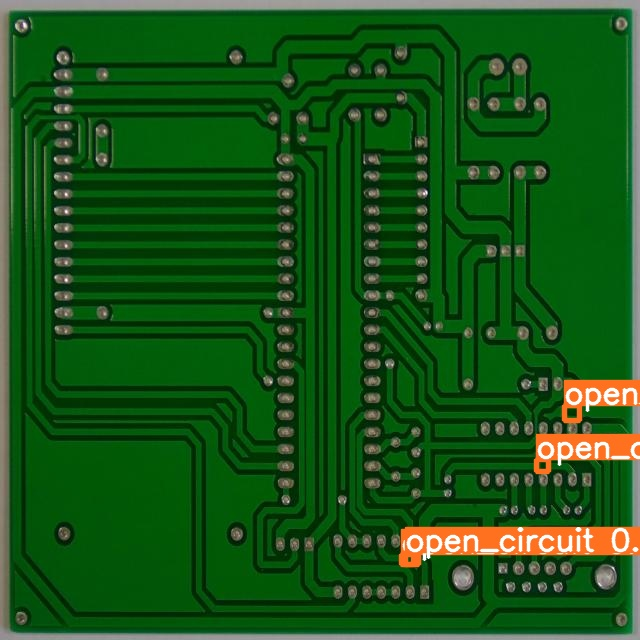

In [ ]:
import glob
from IPython.display import display 

for imageName in glob.glob('/content/yolov5/runs/detect/exp4/*.jpg'):
  display(Image(filename=imageName))
  print("\n")

In [22]:
## Pruebas de video
!python detect.py --weights runs/train/exp3/weights/best.pt --img 640 --conf 0.1 --source 'https://youtu.be/e9dkrmZx7kw'

Streaming output truncated to the last 5000 lines.
0: 384x640 4 missing_holes, 6.6ms
0: 384x640 4 missing_holes, 6.5ms
0: 384x640 4 missing_holes, 6.5ms
0: 384x640 4 missing_holes, 6.5ms
0: 384x640 4 missing_holes, 6.4ms
0: 384x640 4 missing_holes, 9.1ms
0: 384x640 4 missing_holes, 6.3ms
0: 384x640 4 missing_holes, 6.2ms
0: 384x640 4 missing_holes, 6.4ms
0: 384x640 4 missing_holes, 8.6ms
0: 384x640 4 missing_holes, 8.2ms
0: 384x640 4 missing_holes, 6.5ms
0: 384x640 4 missing_holes, 6.5ms
0: 384x640 4 missing_holes, 6.2ms
0: 384x640 4 missing_holes, 6.4ms
0: 384x640 4 missing_holes, 7.0ms
0: 384x640 4 missing_holes, 6.3ms
0: 384x640 4 missing_holes, 6.4ms
0: 384x640 4 missing_holes, 6.3ms
0: 384x640 4 missing_holes, 6.2ms
0: 384x640 4 missing_holes, 6.6ms
0: 384x640 4 missing_holes, 6.9ms
0: 384x640 4 missing_holes, 6.3ms
0: 384x640 4 missing_holes, 7.3ms
0: 384x640 4 missing_holes, 6.4ms
0: 384x640 4 missing_holes, 6.4ms
0: 384x640 4 missing_holes, 6.6ms
0: 384x640 4 missing_holes, 7.3

In [24]:
from google.colab import files
files.download('./runs/detect/exp7/e9dkrmZx7kw.mp4')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>